<a href="https://colab.research.google.com/github/m0zzarella/.NET-Codes/blob/main/CoupledOscillators.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

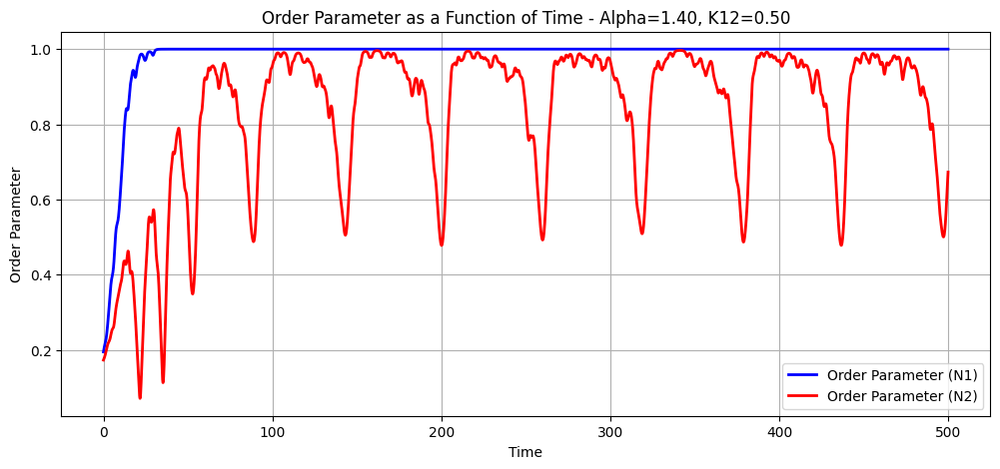

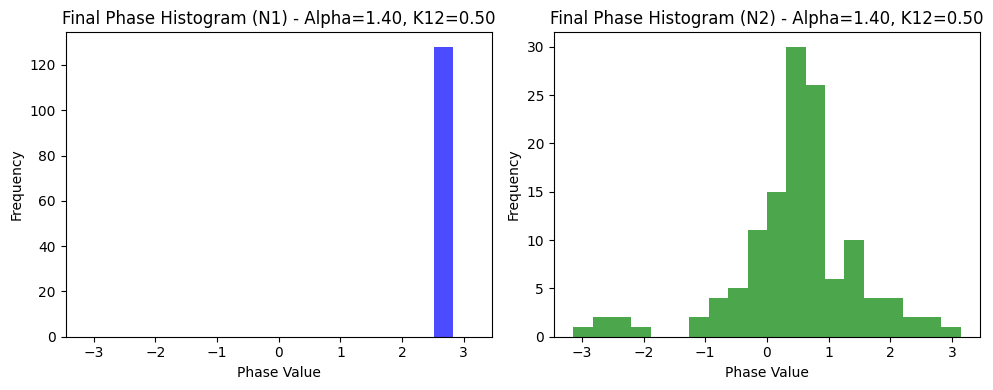

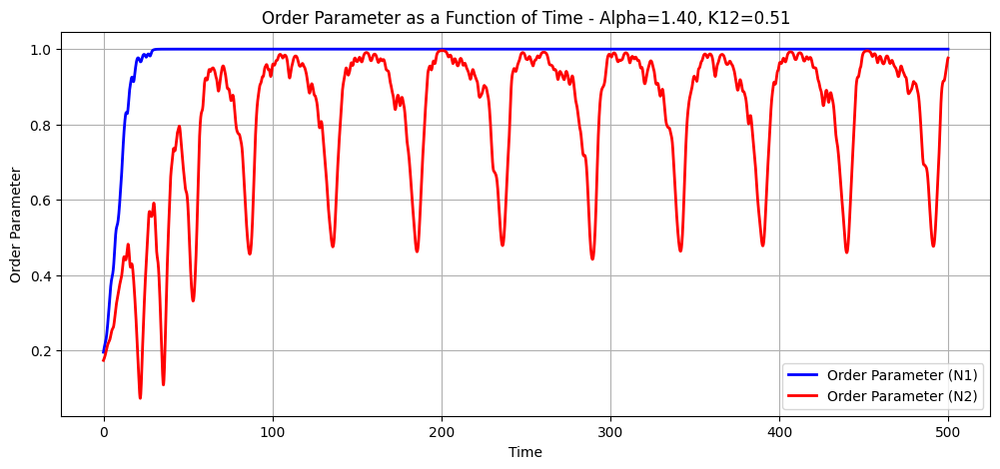

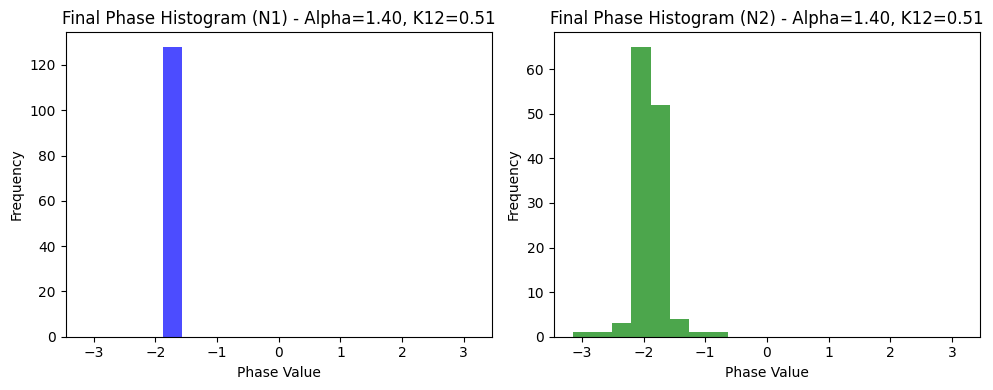

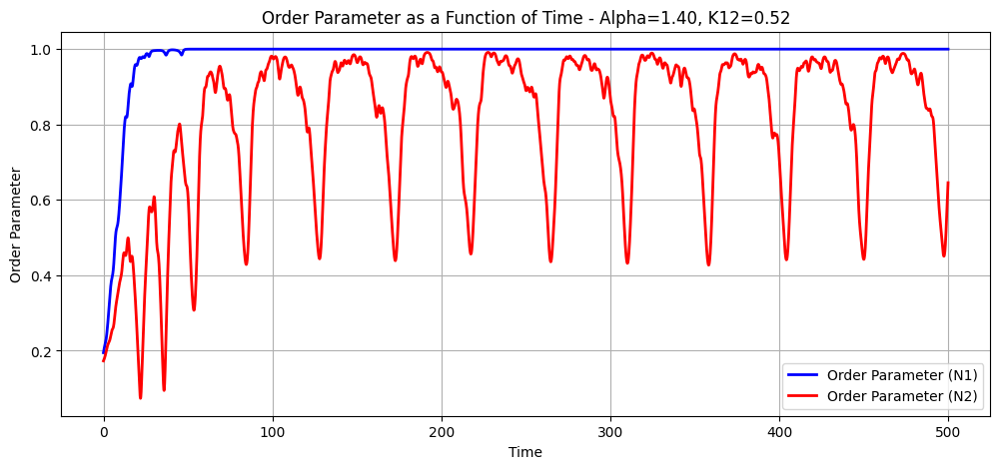

...

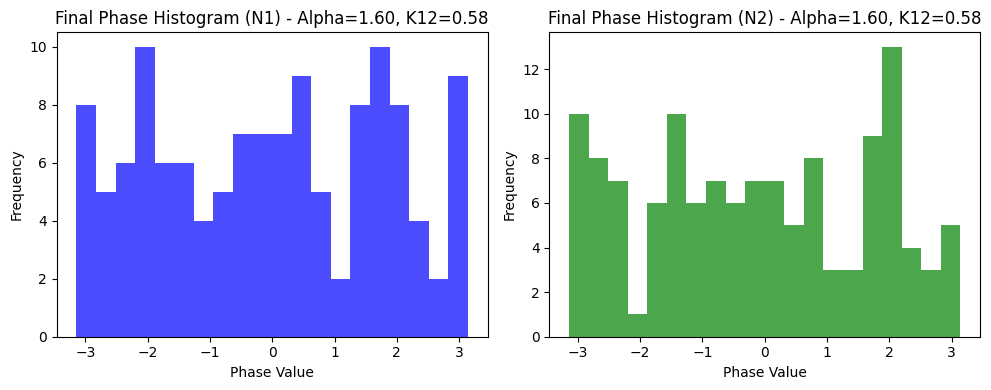

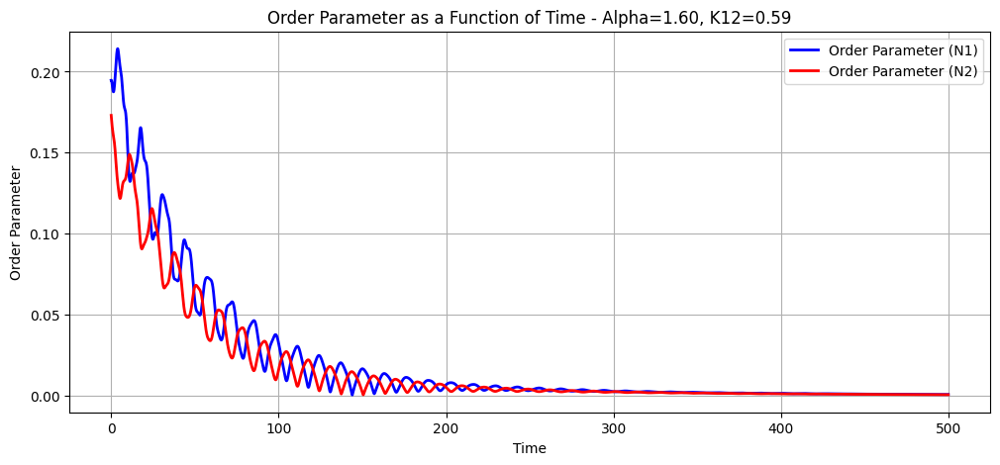

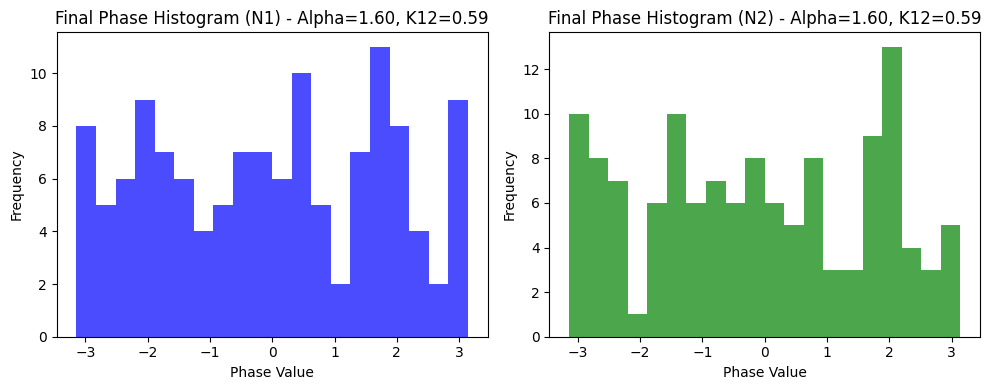

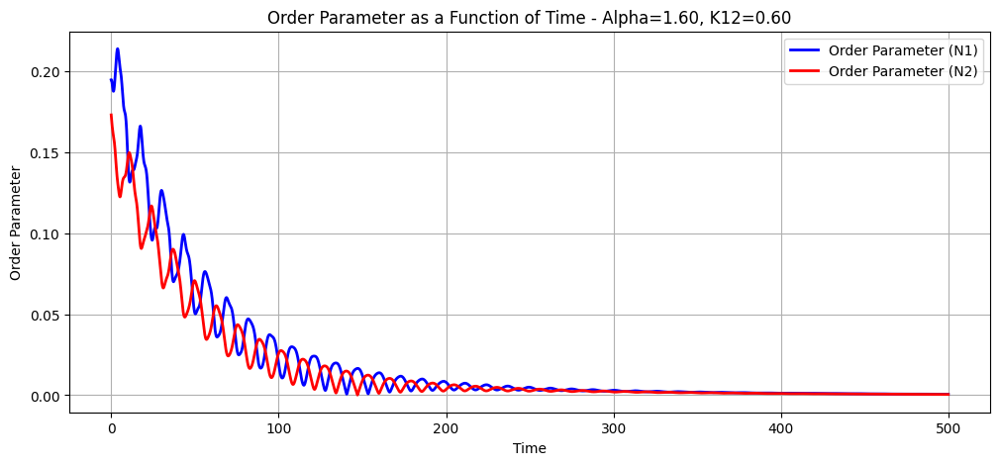

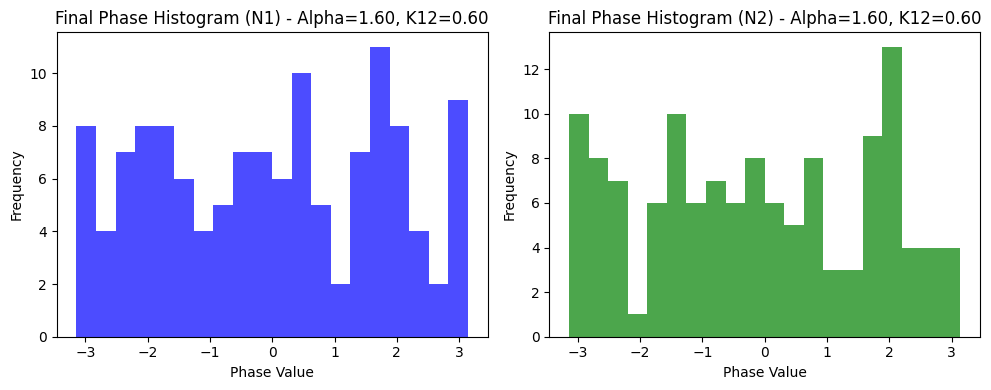

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import odeint
from numba import njit

N = 128
T = 500
dt = 0.1
t = np.arange(0, T, dt)
omega = 1

theta_mean = 0
theta_std = 2
theta_init = np.random.normal(theta_mean, theta_std, (2, N))
theta_init_flat = theta_init.flatten()
delta = 0.1
@njit
def wrap_to_pi(theta):

    return (theta + np.pi) % (2 * np.pi) - np.pi

@njit
def dtheta_dt_flat(theta_flat, t, omega, K, delta, N, alpha):
    theta = theta_flat.reshape(2, N)
    dtheta = np.zeros_like(theta)
    for i in range(2):
        for j in range(N):
            coupling_sum = np.sum(K[i, 0] * np.sin(wrap_to_pi(theta[0, :] - theta[i, j] - alpha))) + \
                           np.sum(K[i, 1] * np.sin(wrap_to_pi(theta[1, :] - theta[i, j] - alpha)))
            dtheta[i, j] = omega + (coupling_sum / N)
    return dtheta.flatten()

def integrate_and_wrap(theta_init_flat, t, omega, K, delta, N, alpha):
    theta_solution_flat = odeint(dtheta_dt_flat, theta_init_flat, t, args=(omega, K, delta, N, alpha))
    theta_solution_wrapped = wrap_to_pi(theta_solution_flat.T).T  # Wrap after integration
    return theta_solution_wrapped

alpha_values = np.linspace(1.4, 1.6, 20)
K_values = [np.array([[1, k12 + delta], [k12 - delta, 1]]) for k12 in np.linspace(0.4, 0.5, 10)]

for alpha in alpha_values:
    for K in K_values:
        theta_solution_flat_wrapped = integrate_and_wrap(theta_init_flat, t, omega, K, delta, N, alpha)
        theta_solution = theta_solution_flat_wrapped.T.reshape(2, N, len(t))

        order_param_population1 = np.abs(np.mean(np.exp(1j * theta_solution[0, :, :]), axis=0))
        order_param_population2 = np.abs(np.mean(np.exp(1j * theta_solution[1, :, :]), axis=0))

        plt.figure(figsize=(12, 5))
        plt.plot(t, order_param_population1, label='Order Parameter (N1)', color='blue', linewidth=2)
        plt.plot(t, order_param_population2, label='Order Parameter (N2)', color='red', linewidth=2)
        plt.title(f'Order Parameter as a Function of Time - Alpha={alpha:.2f}, K12={K[0, 1]:.2f}')
        plt.xlabel('Time')
        plt.ylabel('Order Parameter')
        plt.legend()
        plt.grid(True)
        plt.show()

        plt.figure(figsize=(10, 4))

        plt.subplot(1, 2, 1)
        plt.hist(theta_solution[0, :, -1], bins=20, color='blue', alpha=0.7, range=(-np.pi, np.pi))
        plt.title(f'Final Phase Histogram (N1) - Alpha={alpha:.2f}, K12={K[0, 1]:.2f}')
        plt.xlabel('Phase Value')
        plt.ylabel('Frequency')

        plt.subplot(1, 2, 2)
        plt.hist(theta_solution[1, :, -1], bins=20, color='green', alpha=0.7, range=(-np.pi, np.pi))
        plt.title(f'Final Phase Histogram (N2) - Alpha={alpha:.2f}, K12={K[0, 1]:.2f}')
        plt.xlabel('Phase Value')
        plt.ylabel('Frequency')

        plt.tight_layout()
        plt.show()